### Descritores de Região

Utilizando a imagem anexa:

• Binarize a imagem.

• Crie rótulos para cada componente conexo.

• Crie imagens com cada componente conexo, padronizando-as pelas dimensões da maior.

• Preencha cada componente conexa: não pode haver buracos, somente
silhuetas.


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from skimage import io
from skimage.color import rgb2gray, label2rgb
from skimage.filters import threshold_otsu
from skimage.measure import label, regionprops
from skimage.morphology import convex_hull_image, remove_small_objects 
from scipy.ndimage import binary_fill_holes
from skimage.segmentation import clear_border
import os
from collections import defaultdict
from scipy.spatial.distance import cdist
from sklearn.cluster import AgglomerativeClustering

#### Função para Binarização da Imagem

In [2]:
def carregar_e_binarizar_imagem(caminho, threshold=0.5):
    imagem = io.imread(caminho, as_gray=True)
    imagem_binaria = (imagem < threshold).astype(bool)  # Binarizar (inverter para 0=fundo, 1=frente)
    return imagem_binaria

In [3]:
imagem_binaria_1 = carregar_e_binarizar_imagem("imagem_1.jpg")
imagem_binaria_2 = carregar_e_binarizar_imagem("imagem_2.jpg")

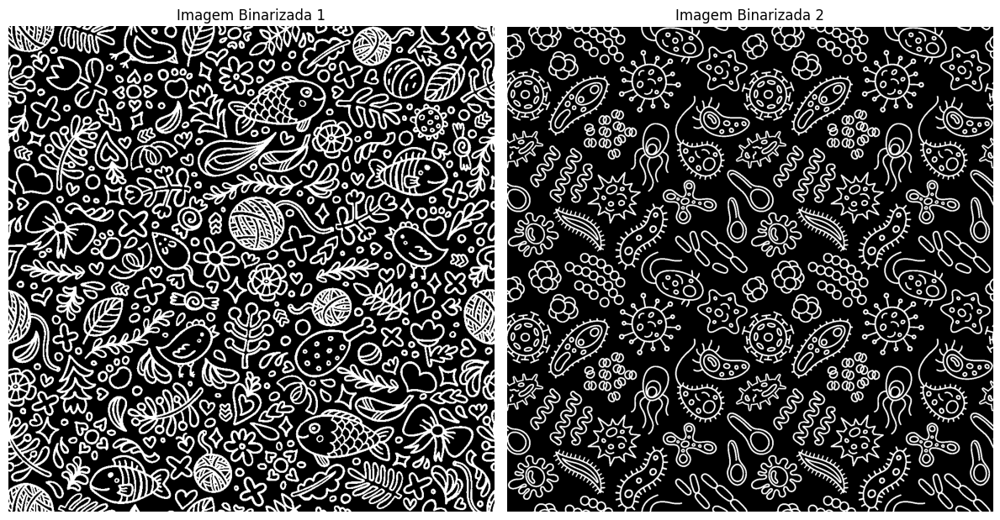

In [4]:
# Criar a figura para exibição
plt.figure(figsize=(12, 8))

# Exibir a primeira imagem (original)
plt.subplot(1, 2, 1)
plt.imshow(imagem_binaria_1, cmap="gray")
plt.title("Imagem Binarizada 1")
plt.axis("off")

# Exibir a segunda imagem (binarizada)
plt.subplot(1, 2, 2)
plt.imshow(imagem_binaria_2, cmap="gray")
plt.title("Imagem Binarizada 2")
plt.axis("off")

# Mostrar as imagens
plt.tight_layout()
plt.show()


#### Função para remover componentes conectados na borda

In [5]:
def remover_componentes_na_borda(imagem_binaria):
    return clear_border(imagem_binaria)

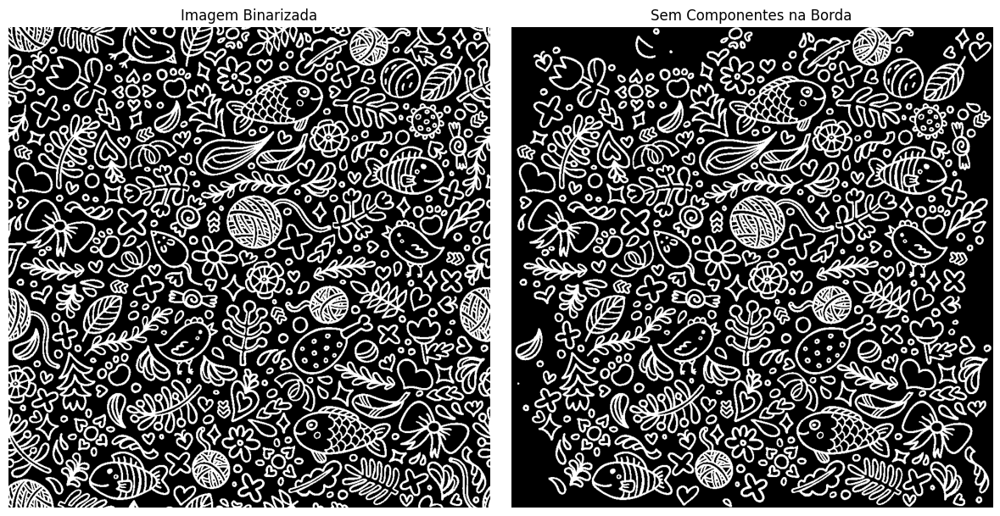

In [6]:
# Remover componentes conectados na borda
imagem_sem_borda_1 = remover_componentes_na_borda(imagem_binaria_1)

# Exibir a imagem original e a modificada
plt.figure(figsize=(12, 6))

# Imagem original binarizada
plt.subplot(1, 2, 1)
plt.imshow(imagem_binaria_1, cmap="gray")
plt.title("Imagem Binarizada")
plt.axis("off")

# Imagem sem componentes na borda
plt.subplot(1, 2, 2)
plt.imshow(imagem_sem_borda_1, cmap="gray")
plt.title("Sem Componentes na Borda")
plt.axis("off")

plt.tight_layout()
plt.show()

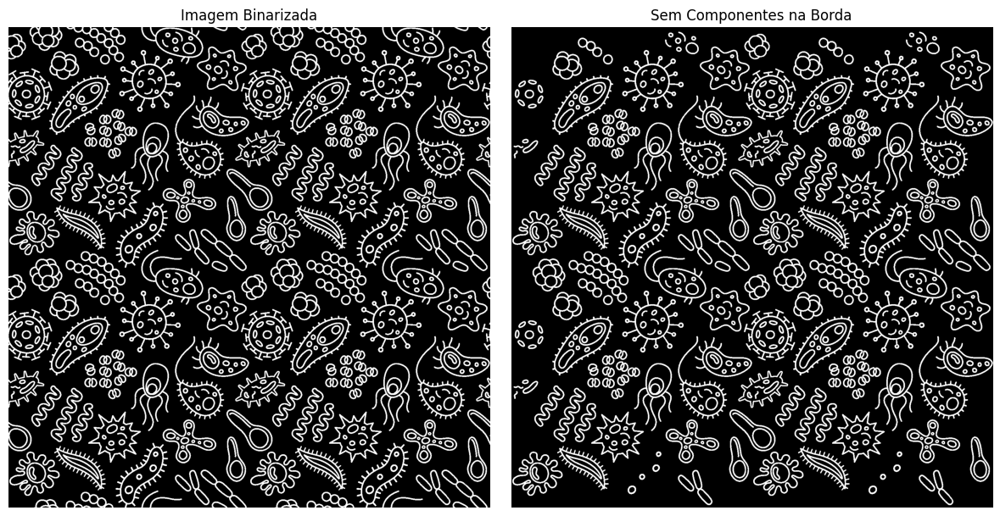

In [7]:
# Remover componentes conectados na borda
imagem_sem_borda_2 = remover_componentes_na_borda(imagem_binaria_2)

# Exibir a imagem original e a modificada
plt.figure(figsize=(12, 6))

# Imagem original binarizada
plt.subplot(1, 2, 1)
plt.imshow(imagem_binaria_2, cmap="gray")
plt.title("Imagem Binarizada")
plt.axis("off")

# Imagem sem componentes na borda
plt.subplot(1, 2, 2)
plt.imshow(imagem_sem_borda_2, cmap="gray")
plt.title("Sem Componentes na Borda")
plt.axis("off")

plt.tight_layout()
plt.show()

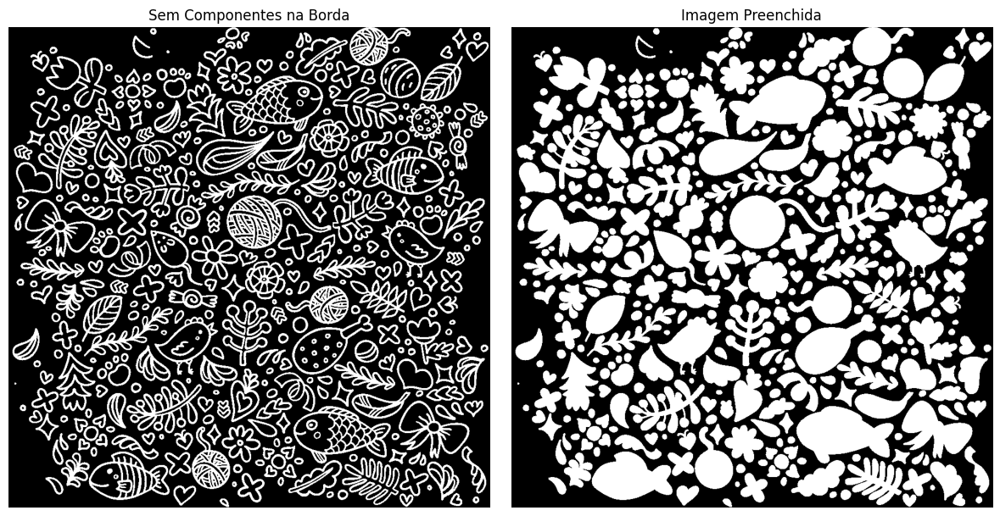

In [8]:
# Preencher as áreas internas (buracos) em cada componente
imagem_preenchida_1 = binary_fill_holes(imagem_sem_borda_1)

# Mostrar os resultados
plt.figure(figsize=(12, 6))

# Imagem original binarizada
plt.subplot(1, 2, 1)
plt.imshow(imagem_sem_borda_1, cmap="gray")
plt.title("Sem Componentes na Borda")
plt.axis("off")

# Imagem sem componentes na borda
plt.subplot(1, 2, 2)
plt.imshow(imagem_preenchida_1, cmap="gray")
plt.title("Imagem Preenchida")
plt.axis("off")

plt.tight_layout()
plt.show()

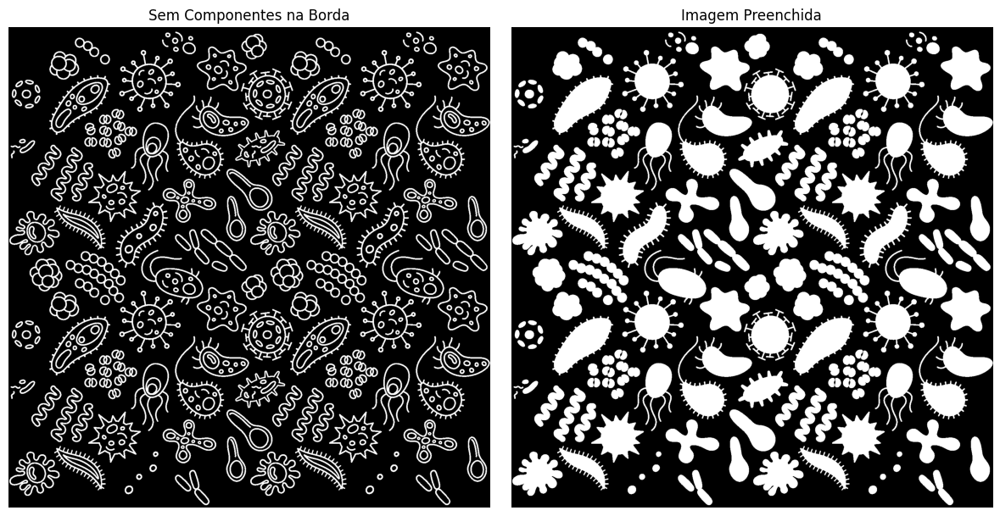

In [9]:
# Preencher as áreas internas (buracos) em cada componente
imagem_preenchida_2 = binary_fill_holes(imagem_sem_borda_2)

# Mostrar os resultados
plt.figure(figsize=(12, 6))

# Imagem original binarizada
plt.subplot(1, 2, 1)
plt.imshow(imagem_sem_borda_2, cmap="gray")
plt.title("Sem Componentes na Borda")
plt.axis("off")

# Imagem sem componentes na borda
plt.subplot(1, 2, 2)
plt.imshow(imagem_preenchida_2, cmap="gray")
plt.title("Imagem Preenchida")
plt.axis("off")

plt.tight_layout()
plt.show()

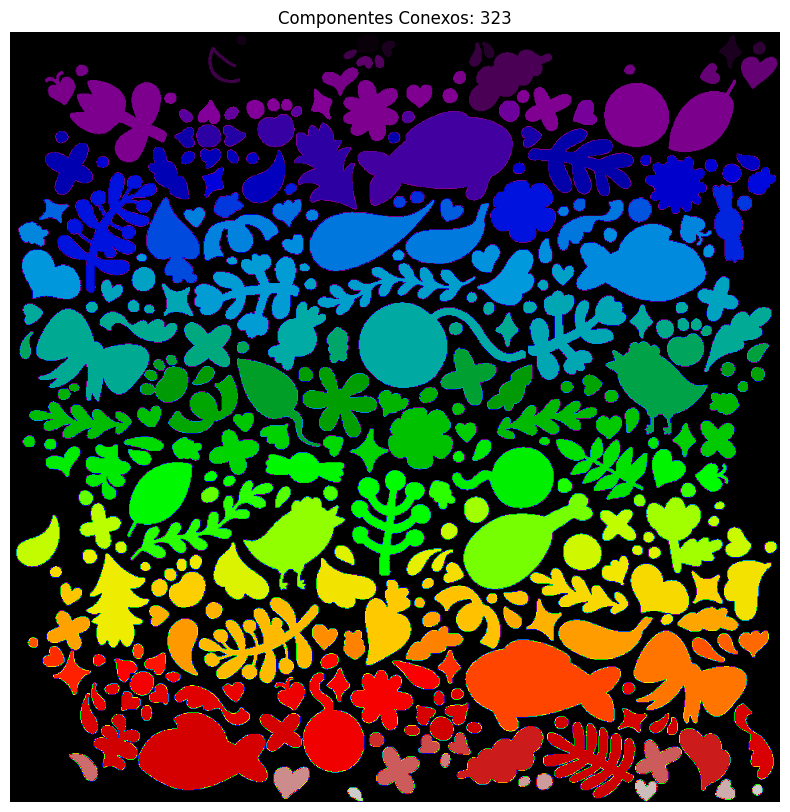

Número de componentes conexos: 323


In [10]:
# Remover ruídos pequenos
imagem_limpa_01 = remove_small_objects(imagem_preenchida_1, min_size=100)

# Rotular os componentes conexos
rotulos_1, num_componentes_1 = label(imagem_limpa_01, connectivity=2, return_num=True)

# Mostrar a imagem rotulada
plt.figure(figsize=(10, 10))
plt.title(f'Componentes Conexos: {num_componentes_1}')
plt.imshow(rotulos_1, cmap='nipy_spectral')
plt.axis('off')
plt.show()

print(f"Número de componentes conexos: {num_componentes_1}")

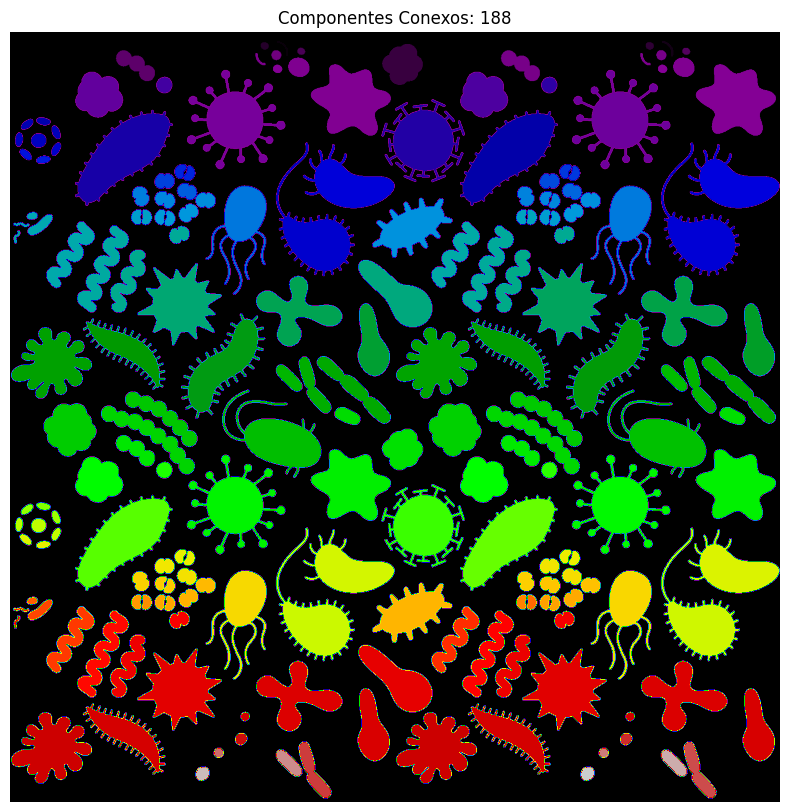

Número de componentes conexos: 188


In [11]:
# Remover ruídos pequenos
imagem_limpa_2 = remove_small_objects(imagem_preenchida_2, min_size=100)

# Rotular os componentes conexos
rotulos_2, num_componentes_2 = label(imagem_limpa_2, connectivity=2, return_num=True)

# Mostrar a imagem rotulada
plt.figure(figsize=(10, 10))
plt.title(f'Componentes Conexos: {num_componentes_2}')
plt.imshow(rotulos_2, cmap='nipy_spectral')
plt.axis('off')
plt.show()

print(f"Número de componentes conexos: {num_componentes_2}")



# Descritores de Região

## 1. Área (\( A \))
A área de um componente conexo é o número total de pixels que compõem a região:

$$
A = \sum_{i, j \in R} 1
$$

---

## 2. Perímetro (\( P \))
O perímetro é o comprimento do contorno da região:

$$
P = \text{Número de pixels na borda da região}
$$

---

## 3. Compacidade (\( C \))
A compacidade mede quão próxima a forma da região está de um círculo:

$$
C = \frac{P^2}{4\pi A}
$$

---

## 4. Quociente Isoperimétrico (\( Q \))
Outra métrica para circularidade, inversa da compacidade:

$$
Q = \frac{4 \pi A}{P^2}
$$

---

## 5. Eixo Maior (\( a \)) e Eixo Menor (\( b \))
Os eixos maior e menor são os comprimentos das semiaxes da elipse equivalente à região:

$$
a, b = \text{Eixos principais calculados pela Análise de Componentes Principais (PCA)}
$$

---

## 6. Excentricidade (\( E \))
A excentricidade mede o alongamento da elipse equivalente:

$$
E = \sqrt{1 - \frac{b^2}{a^2}} \quad \text{(onde \( a \geq b \))}
$$

---

## 7. Convexidade (\( Conv \))
A convexidade é a razão entre o perímetro do casco convexo e o perímetro da região:

$$
Conv = \frac{P_\text{convexo}}{P}
$$

---

## 8. Retangularidade (\( R \))
A retangularidade mede a proporção entre a área da região e a área do menor retângulo que a contém:

$$
R = \frac{A}{A_\text{bounding box}}
$$

---

## 9. Solidez (\( S \))
A solidez é a razão entre a área da região e a área de seu casco convexo:

$$
S = \frac{A}{A_\text{convexo}}
$$


In [12]:
# Função para calcular os descritores
def calcular_descritores(component):
    region = regionprops(component.astype(int))[0]
    area = region.area
    perimetro = region.perimeter
    compacidade = perimetro ** 2 / (4 * np.pi * area)
    quociente_isoperimetrico = (4 * np.pi * area) / (perimetro ** 2)
    eixo_maior = region.major_axis_length
    eixo_menor = region.minor_axis_length
    excentricidade = region.eccentricity
    convex_image = convex_hull_image(component)
    convex_area = np.sum(convex_image)
    convexidade = convex_area / area
    retangularidade = area / (eixo_maior * eixo_menor)
    solidez = area / convex_area

    return {
        "Área": area,
        "Perímetro": perimetro,
        "Compacidade": compacidade,
        "Quociente Isoperimétrico": quociente_isoperimetrico,
        "Eixo Maior": eixo_maior,
        "Eixo Menor": eixo_menor,
        "Excentricidade": excentricidade,
        "Convexidade": convexidade,
        "Retangularidade": retangularidade,
        "Solidez": solidez
    }

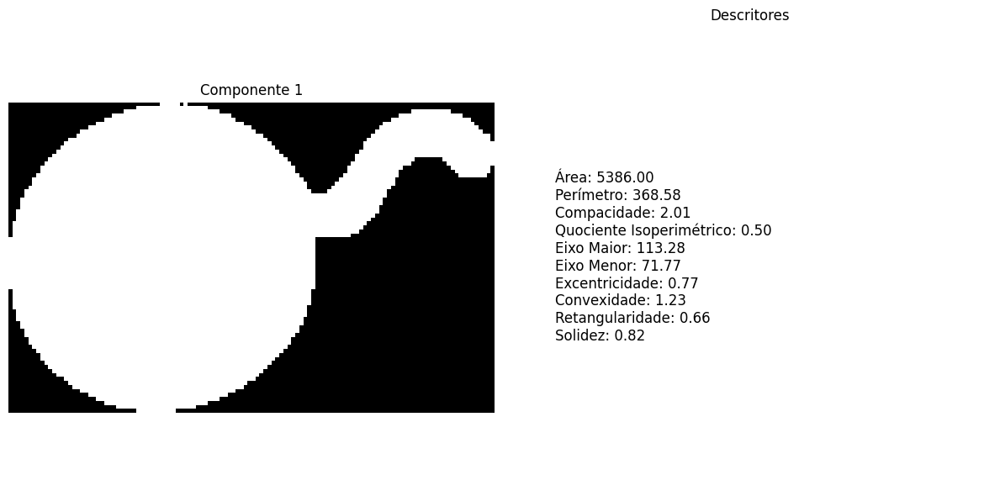

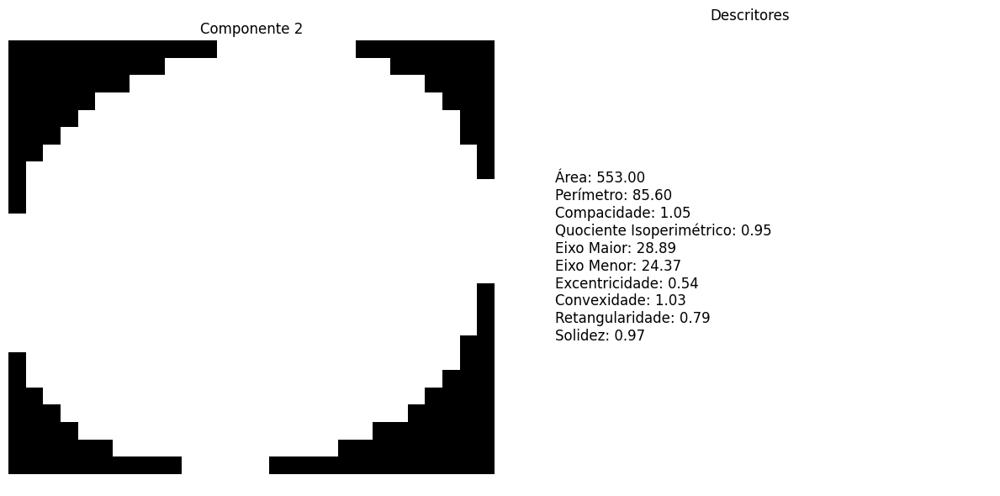

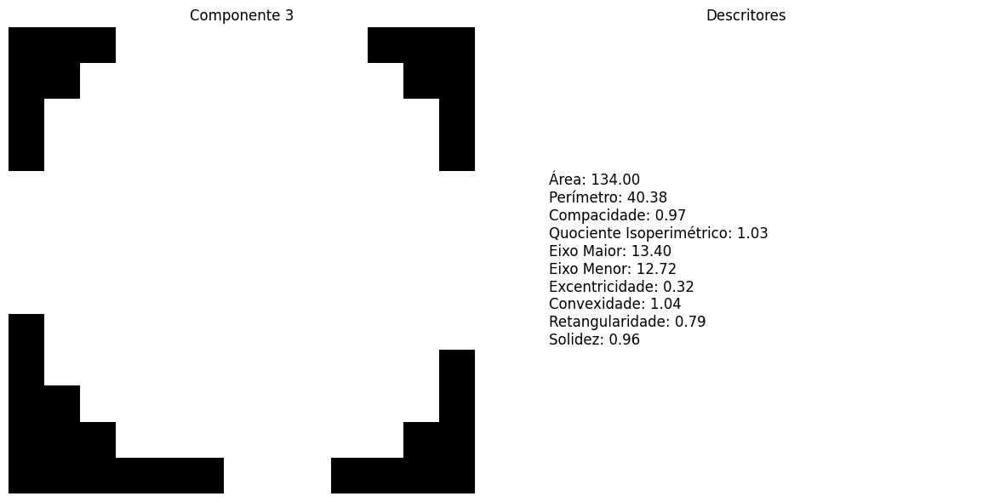

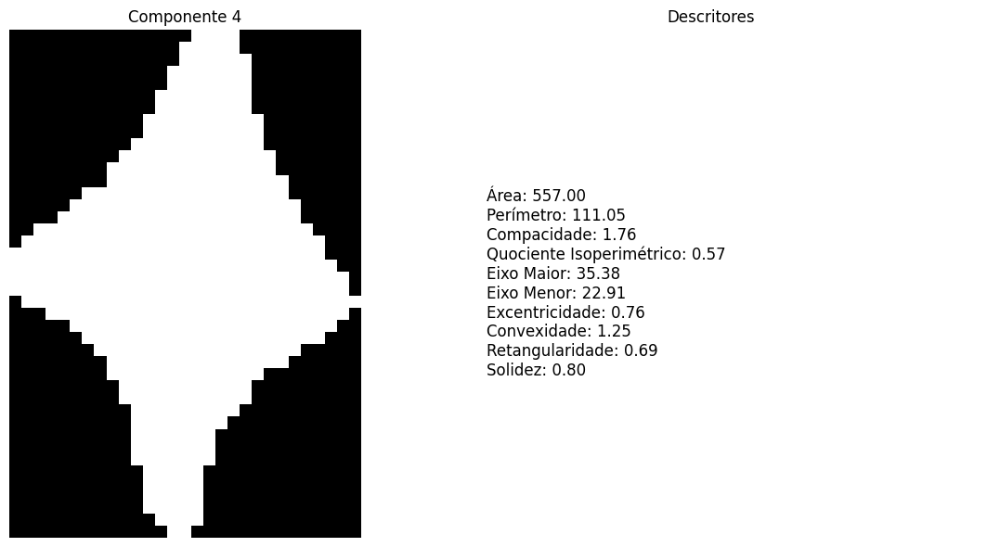

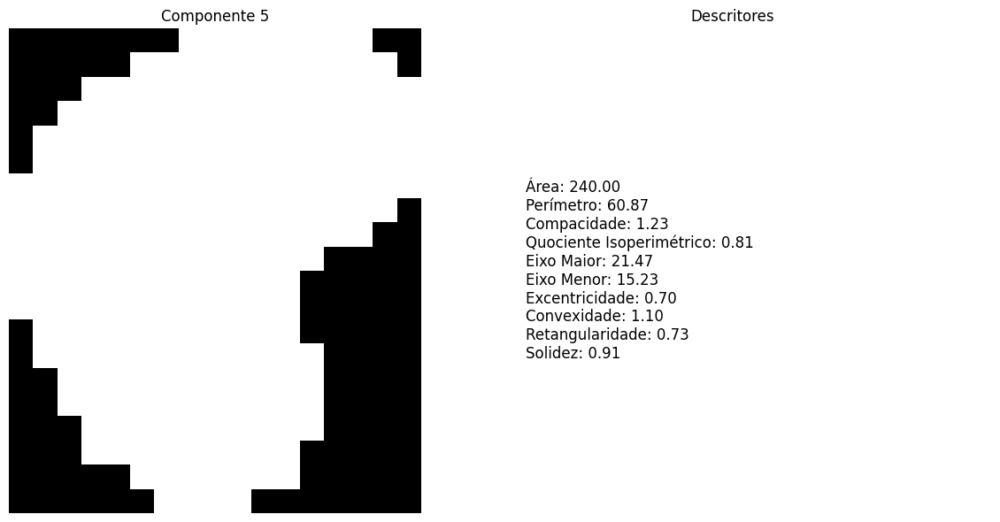

...

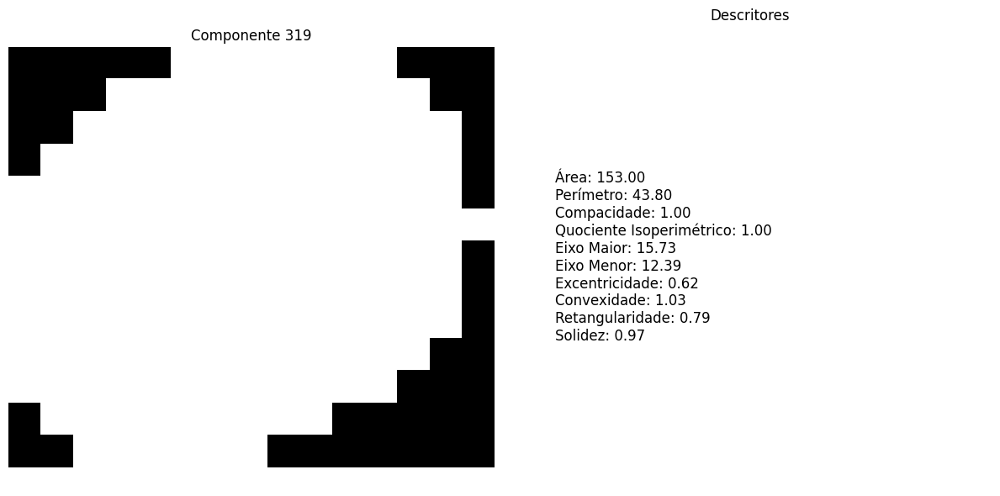

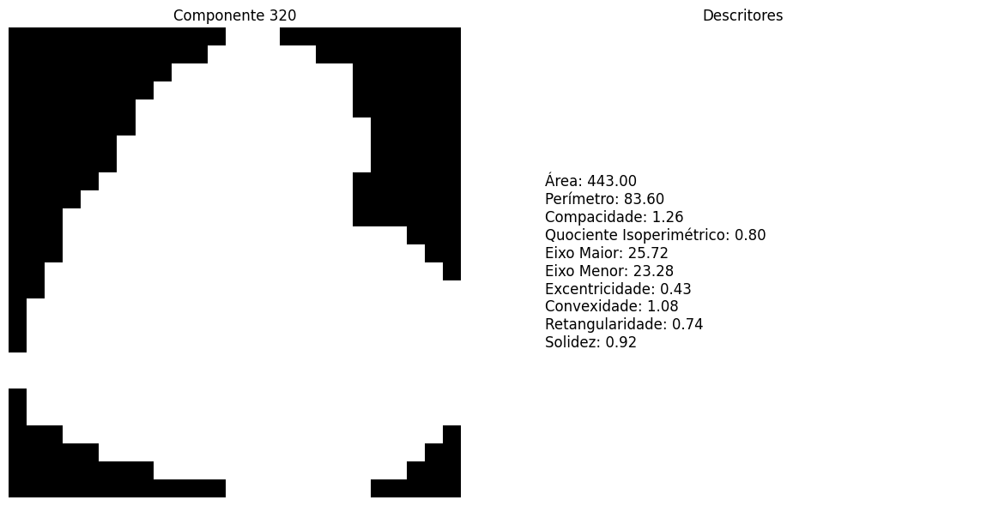

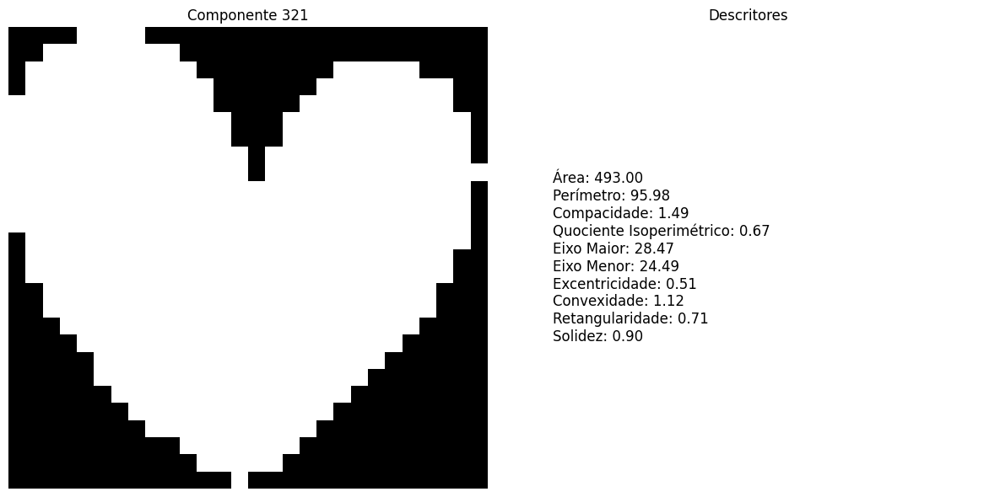

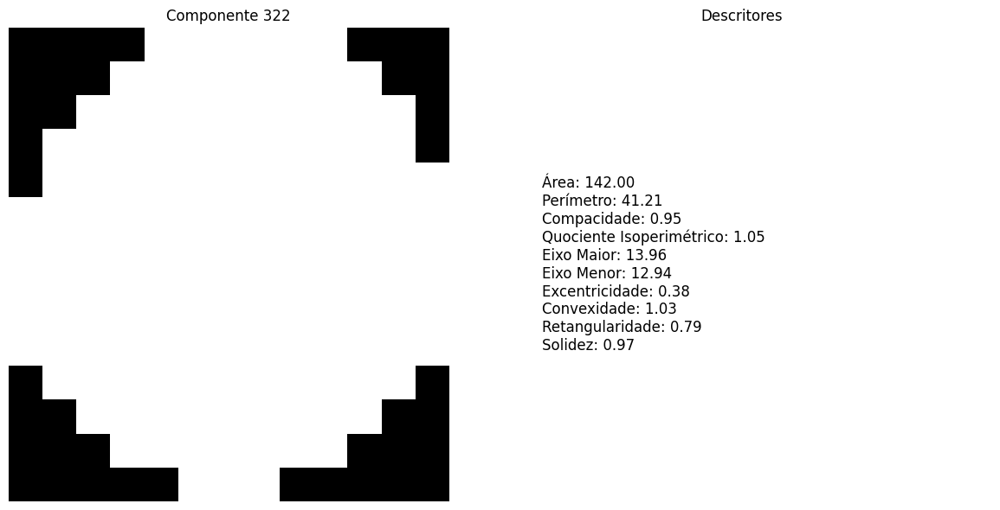

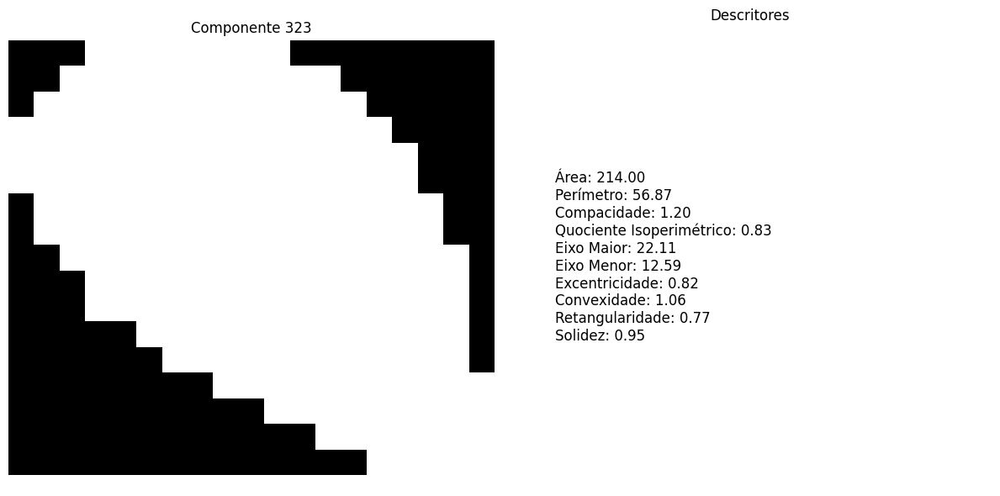

In [13]:
# Criar uma imagem para cada componente conexo e mostrar os descritores
for region in regionprops(rotulos_1):
    # Pegar coordenadas do bounding box do componente
    minr, minc, maxr, maxc = region.bbox
    
    # Extrair o componente da imagem original
    componente = (rotulos_1[minr:maxr, minc:maxc] == region.label).astype(np.uint8)
    
    # Calcular os descritores
    descritores = calcular_descritores(componente)
    
    # Mostrar a imagem e os descritores lado a lado
    plt.figure(figsize=(12, 6))
    
    # Exibir o componente
    plt.subplot(1, 2, 1)
    plt.imshow(componente, cmap="gray")
    plt.title(f"Componente {region.label}")
    plt.axis("off")
    
    # Exibir os descritores
    plt.subplot(1, 2, 2)
    descritores_texto = "\n".join([f"{key}: {value:.2f}" for key, value in descritores.items()])
    plt.text(0.1, 0.5, descritores_texto, fontsize=12, va="center", ha="left")
    plt.axis("off")
    plt.title("Descritores")
    
    plt.tight_layout()
    plt.show()

#### Verificando sem tem mais de um igual

In [ ]:
# Função para agrupar componentes iguais
def agrupar_componentes_por_descritores(rotulos):
    descritores_componentes = []
    componentes = []

    # Para cada componente conexo, calcular descritores
    for region in regionprops(rotulos):
        minr, minc, maxr, maxc = region.bbox
        componente = (rotulos[minr:maxr, minc:maxc] == region.label).astype(np.uint8)
        descritores = calcular_descritores(componente)
        descritores_componentes.append((region.label, descritores))
        componentes.append(componente)

    # Agrupar componentes por descritores
    agrupamento = defaultdict(list)
    for label, descritor in descritores_componentes:
        descritor_chave = tuple(descritor.items())  # Converter descritor para um tipo hashable
        agrupamento[descritor_chave].append(label)

    return agrupamento, componentes

# Aplicar a função de agrupamento nos componentes
agrupamento, componentes = agrupar_componentes_por_descritores(rotulos_1)

# Exibir os agrupamentos
print("Agrupamento de Componentes Conexos Iguais:")
for descritor_chave, labels in agrupamento.items():
    print(f"\nDescritores: {dict(descritor_chave)}")
    print(f"Componentes Iguais: {len(labels)}")
    print(f"IDs dos Componentes: {labels}")

In [ ]:
# Exibir os agrupamentos em ordem decrescente pelo número de componentes iguais
agrupamento_ordenado = sorted(agrupamento.items(), key=lambda x: len(x[1]), reverse=True)

print("Agrupamento de Componentes Conexos Iguais (Ordenado por Quantidade):")
for index, (descritor_chave, labels) in enumerate(agrupamento_ordenado, start=1):
    print(f"\nGrupo {index}:")
    print(f"Descritores: {dict(descritor_chave)}")
    print(f"Quantidade de Componentes Iguais: {len(labels)}")
    print(f"IDs dos Componentes: {labels}")

    # Exibir visualmente os componentes desse grupo
    for label in labels[:3]:  # Exibe até 3 componentes de cada grupo
        component = (rotulos_1 == label).astype(np.uint8)
        plt.figure()
        plt.imshow(component, cmap="gray")
        plt.title(f"Componente {label} (Grupo {index})")
        plt.axis("off")
        plt.show()


## Clusster

In [14]:

# Função para calcular descritores de região
def calcular_descritores(region):
    area = region.area
    perimetro = region.perimeter
    compacidade = perimetro ** 2 / area if area > 0 else 0
    quociente_isoperimetrico = (4 * np.pi * area) / (perimetro ** 2) if perimetro > 0 else 0
    eixo_maior = region.major_axis_length
    eixo_menor = region.minor_axis_length
    excentricidade = region.eccentricity
    convexidade = (region.convex_area - area) / area if area > 0 else 0
    retangularidade = area / region.bbox_area if region.bbox_area > 0 else 0
    solidez = region.solidity
    return [area, perimetro, compacidade, quociente_isoperimetrico,
            eixo_maior, eixo_menor, excentricidade, convexidade, retangularidade, solidez]


In [15]:
# Função para extrair componentes conexos e descritores
def extrair_descritores(imagem_binaria):
    label_image = label(imagem_binaria)
    descritores_vd = []
    descritores_va = []
    for region in regionprops(label_image):
        if region.area > 5:  # Ignorar regiões muito pequenas
            vd = calcular_descritores(region)
            va = vd[2:]  # Somente descritores adimensionais
            descritores_vd.append(vd)
            descritores_va.append(va)
    return np.array(descritores_vd), np.array(descritores_va), label_image


In [16]:
# Função para construir matriz de distância
def construir_matriz_distancia(descritores):
    return cdist(descritores, descritores, metric="euclidean")


In [17]:
# Função para realizar clustering (corrigida)
def agrupar_componentes(matriz_distancia, n_clusters):
    clustering = AgglomerativeClustering(n_clusters=n_clusters, metric="precomputed", linkage="average")
    labels = clustering.fit_predict(matriz_distancia)
    return labels

In [18]:
# Função para colorir clusters
def colorir_clusters(label_image, cluster_labels):
    # Criar uma imagem colorida baseada nos clusters
    colored_image = np.zeros_like(label_image, dtype=int)

    # Garantir que a correspondência entre label_image e cluster_labels esteja correta
    max_label = np.max(label_image)
    for label in range(1, max_label + 1):  # Ignorar o fundo (0)
        if label - 1 < len(cluster_labels):  # Garantir que o índice seja válido
            cluster = cluster_labels[label - 1]
            colored_image[label_image == label] = cluster + 1  # Cluster + 1 para evitar 0 como cluster válido

    return label2rgb(colored_image, bg_label=0)


In [19]:
# Extrair descritores e componentes
descritores_vd, descritores_va, label_image = extrair_descritores(imagem_preenchida_2)

# Construir matrizes de distância
matriz_distancia_vd = construir_matriz_distancia(descritores_vd)
matriz_distancia_va = construir_matriz_distancia(descritores_va)

# Agrupar componentes
n_clusters = 15  # Ajuste conforme necessário
clusters_vd = agrupar_componentes(matriz_distancia_vd, n_clusters)

# Colorir os clusters
imagem_colorida = colorir_clusters(label_image, clusters_vd)



In [26]:
matriz_distancia_va

array([[ 0.        ,  0.21910674, 40.23634172, ..., 40.29170406,
        36.24764768, 36.24764768],
       [ 0.21910674,  0.        , 40.03584246, ..., 40.20202744,
        36.03605029, 36.03605029],
       [40.23634172, 40.03584246,  0.        , ..., 56.51848338,
        16.83407172, 16.83407172],
       ...,
       [40.29170406, 40.20202744, 56.51848338, ...,  0.        ,
        42.93514468, 42.93514468],
       [36.24764768, 36.03605029, 16.83407172, ..., 42.93514468,
         0.        ,  0.        ],
       [36.24764768, 36.03605029, 16.83407172, ..., 42.93514468,
         0.        ,  0.        ]])

In [ ]:
# Iterar sobre diferentes números de clusters
for num_clusters in range(2, 31):  # Começar com pelo menos 2 clusters
    print(f"Visualizando com {num_clusters} clusters...")
    
    # Agrupar componentes
    clusters_vd = agrupar_componentes(matriz_distancia_va, num_clusters)
    
    # Colorir os clusters
    imagem_colorida = colorir_clusters(label_image, clusters_vd)
    
    # Plotar os resultados
    plt.figure(figsize=(12, 6))
    
    # Imagem binarizada
    plt.subplot(1, 2, 1)
    plt.imshow(imagem_preenchida_2, cmap="gray")
    plt.title("Imagem Binarizada")
    plt.axis("off")

    # Clusters coloridos
    plt.subplot(1, 2, 2)
    plt.imshow(imagem_colorida)
    plt.title(f"Clusters - {num_clusters} Agrupamentos Matriz VA")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


In [ ]:
# Iterar sobre diferentes números de clusters
for num_clusters in range(2, 31):  # Começar com pelo menos 2 clusters
    print(f"Visualizando com {num_clusters} clusters...")
    
    # Agrupar componentes
    clusters_vd = agrupar_componentes(matriz_distancia_vd, num_clusters)
    
    # Colorir os clusters
    imagem_colorida = colorir_clusters(label_image, clusters_vd)
    
    # Plotar os resultados
    plt.figure(figsize=(12, 6))
    
    # Imagem binarizada
    plt.subplot(1, 2, 1)
    plt.imshow(imagem_preenchida_2, cmap="gray")
    plt.title("Imagem Binarizada")
    plt.axis("off")

    # Clusters coloridos
    plt.subplot(1, 2, 2)
    plt.imshow(imagem_colorida)
    plt.title(f"Clusters - {num_clusters} Agrupamentos Matriz VD")
    plt.axis("off")

    plt.tight_layout()
    plt.show()
